**EDA para sistema de recomendación**

In [1]:
#Acá se empieza el proceso de EDA para realizar el sistema de recomendación
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [2]:
#cargamos el dataframe final
df = pd.read_csv("final_clean.csv", parse_dates=['release_date'], date_parser=lambda x: pd.to_datetime(x, format='%Y-%m-%d'))

In [3]:
pd.set_option('display.max_columns', None)


In [4]:
df.head()

,budget,id,original_language,popularity,release_date,revenue,runtime,status,title,vote_average,vote_count,name_collec,iso_3166_1,name_country,iso_639_1,name_language,release_year,return,actors,directors,genre,productor
0,30000000.0,862,en,21.946943,1995-10-30,373554033.0,81.0,Released,Toy Story,7.7,5415.0,Toy Story Collection,US,United States of America,en,English,1995,12.451801,['Tom Hanks' 'Tim Allen' 'Don Rickles' 'Jim Va...,['John Lasseter'],"['Animation', 'Comedy', 'Family']","['Pixar Animation Studios', nan]"
1,65000000.0,8844,en,17.015539,1995-12-15,262797249.0,104.0,Released,Jumanji,6.9,2413.0,NaN,US,United States of America,en,English,1995,4.043035,['Robin Williams' 'Jonathan Hyde' 'Kirsten Dun...,['Joe Johnston'],"['Adventure', 'Fantasy', 'Family']","['TriStar Pictures', 'Teitler Film']"
2,0.0,15602,en,11.712900,1995-12-22,0.0,101.0,Released,Grumpier Old Men,6.5,92.0,Grumpy Old Men Collection,US,United States of America,en,English,1995,0.000000,['Walter Matthau' 'Jack Lemmon' 'Ann-Margret' ...,['Howard Deutch'],"['Romance', 'Comedy', nan]","['Warner Bros.', 'Lancaster Gate']"
3,16000000.0,31357,en,3.859495,1995-12-22,81452156.0,127.0,Released,Waiting to Exhale,6.1,34.0,NaN,US,United States of America,en,English,1995,5.090760,['Whitney Houston' 'Angela Bassett' 'Loretta D...,['Forest Whitaker'],"['Comedy', 'Drama', 'Romance']","['Twentieth Century Fox Film Corporation', nan]"
4,0.0,11862,en,8.387519,1995-02-10,76578911.0,106.0,Released,Father of the Bride Part II,5.7,173.0,Father of the Bride Collection,US,United States of America,en,English,1995,0.000000,['Steve Martin' 'Diane Keaton' 'Martin Short' ...,['Charles Shyer'],"['Comedy', nan, nan]","['Sandollar Productions', 'Touchstone Pictures']"


In [4]:
#Eliminamos columnas que no son reelevantes para un sistema de recomendaciones
columnas_elimi = ["id", "original_language", "status", "iso_3166_1", "iso_639_1"]
df = df.drop(columnas_elimi, axis = 1)

In [6]:
df.head()

,budget,popularity,release_date,revenue,runtime,title,vote_average,vote_count,name_collec,name_country,name_language,release_year,return,actors,directors,genre,productor
0,30000000.0,21.946943,1995-10-30,373554033.0,81.0,Toy Story,7.7,5415.0,Toy Story Collection,United States of America,English,1995,12.451801,['Tom Hanks' 'Tim Allen' 'Don Rickles' 'Jim Va...,['John Lasseter'],"['Animation', 'Comedy', 'Family']","['Pixar Animation Studios', nan]"
1,65000000.0,17.015539,1995-12-15,262797249.0,104.0,Jumanji,6.9,2413.0,NaN,United States of America,English,1995,4.043035,['Robin Williams' 'Jonathan Hyde' 'Kirsten Dun...,['Joe Johnston'],"['Adventure', 'Fantasy', 'Family']","['TriStar Pictures', 'Teitler Film']"
2,0.0,11.712900,1995-12-22,0.0,101.0,Grumpier Old Men,6.5,92.0,Grumpy Old Men Collection,United States of America,English,1995,0.000000,['Walter Matthau' 'Jack Lemmon' 'Ann-Margret' ...,['Howard Deutch'],"['Romance', 'Comedy', nan]","['Warner Bros.', 'Lancaster Gate']"
3,16000000.0,3.859495,1995-12-22,81452156.0,127.0,Waiting to Exhale,6.1,34.0,NaN,United States of America,English,1995,5.090760,['Whitney Houston' 'Angela Bassett' 'Loretta D...,['Forest Whitaker'],"['Comedy', 'Drama', 'Romance']","['Twentieth Century Fox Film Corporation', nan]"
4,0.0,8.387519,1995-02-10,76578911.0,106.0,Father of the Bride Part II,5.7,173.0,Father of the Bride Collection,United States of America,English,1995,0.000000,['Steve Martin' 'Diane Keaton' 'Martin Short' ...,['Charles Shyer'],"['Comedy', nan, nan]","['Sandollar Productions', 'Touchstone Pictures']"


In [5]:
#Por cuestiones de tiempo usamos esta librería para tener una descripción detalla del dataframe
from ydata_profiling import ProfileReport


In [8]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
#En primer lugar con base en la información suministrada procedemos a eliminar las columnas donde la cantidad de 0 y valores faltantes es superior al 40% y 
#que no son relevantes para el sistema de recomendación
columnas = ["name_collec", "budget", "revenue", "return" ]
df = df.drop(columnas, axis=1)

In [10]:
#realizamos de nuevo el análisis
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [11]:
plt.switch_backend('tkagg')


Text(0.5, 1.0, 'Histograma de Frecuencia')

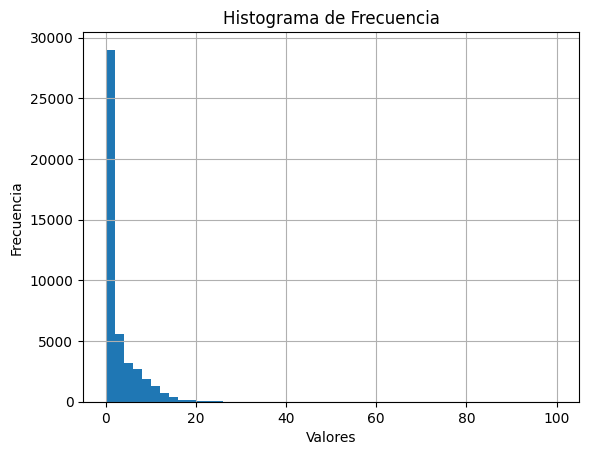

In [13]:
#Ahora nos centramos en la columna popularidad
#Como el reporte nos indica la popularidad tiene un cesgo muy grande hacia la derecha, esto quiere decir que muchas películas no son muy populares 
#y se encuentran en su mayoría dentro de un mismo rango, pero existen algunas con valores muy altos de popularidad
plt.switch_backend('tkagg')
%matplotlib inline
df['popularity'].hist(range=(0, 100), bins=50)
plt.xlabel('Valores')
plt.ylabel('Frecuencia')
plt.title('Histograma de Frecuencia')


In [24]:
#con base en esa gráfica podemos deducir que la mayoría de los valores se encuentra entre 0 y 15 aproximadamente
#De igual manera con base en el percentil 95 que es 11.06 confirmamos que el 95% de los valores es igual o menor que este número


In [7]:
#Ahora analizamos el vote average
#Con base en la información del reporte vemos que existen muchos valores con un voto promedio de 0, por lo que hay que observar si se debe a que no tiene votos
#o si realmente la película tiene tan mala colificación
df_filtrado = df[(df["vote_average"] == 0) & (df["vote_count"] == 0)]


In [8]:
df_filtrado.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2847 entries, 83 to 45358
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   popularity     2847 non-null   float64       
 1   release_date   2847 non-null   datetime64[ns]
 2   runtime        2755 non-null   float64       
 3   title          2847 non-null   object        
 4   vote_average   2847 non-null   float64       
 5   vote_count     2847 non-null   float64       
 6   name_country   1751 non-null   object        
 7   name_language  1946 non-null   object        
 8   release_year   2847 non-null   int64         
 9   actors         2847 non-null   object        
 10  directors      2847 non-null   object        
 11  genre          2847 non-null   object        
 12  productor      2847 non-null   object        
dtypes: datetime64[ns](1), float64(4), int64(1), object(7)
memory usage: 311.4+ KB


In [9]:
#vemos que la mayoría de películas con promedio de voto 0 se debe a que no tienen ningún voto, por lo que se procede a cambiar estos valores de vote_average
#por el promedio de todas las películas
promedio = df.loc[df["vote_average"] != 0, "vote_average"].mean()

In [10]:
condicion = (df["vote_average"] == 0) & (df["vote_count"] == 0)
df.loc[condicion, "vote_average"] = promedio

In [16]:
df.columns

Index(['popularity', 'release_date', 'runtime', 'title', 'vote_average',
       'vote_count', 'name_country', 'name_language', 'release_year', 'actors',
       'directors', 'genre', 'productor'],
      dtype='object')

In [11]:
#eliminamos el resto de columnas poco relevantes para el sistema de recomendación como lo son el año de lanzamiento, la fecha y la duración
final_columns = ["release_year", "release_year", "runtime", "name_country"]
df = df.drop(final_columns, axis=1)

In [18]:
df.head()

,popularity,release_date,title,vote_average,vote_count,name_language,actors,directors,genre,productor
0,21.946943,1995-10-30,Toy Story,7.7,5415.0,English,['Tom Hanks' 'Tim Allen' 'Don Rickles' 'Jim Va...,['John Lasseter'],"['Animation', 'Comedy', 'Family']","['Pixar Animation Studios', nan]"
1,17.015539,1995-12-15,Jumanji,6.9,2413.0,English,['Robin Williams' 'Jonathan Hyde' 'Kirsten Dun...,['Joe Johnston'],"['Adventure', 'Fantasy', 'Family']","['TriStar Pictures', 'Teitler Film']"
2,11.712900,1995-12-22,Grumpier Old Men,6.5,92.0,English,['Walter Matthau' 'Jack Lemmon' 'Ann-Margret' ...,['Howard Deutch'],"['Romance', 'Comedy', nan]","['Warner Bros.', 'Lancaster Gate']"
3,3.859495,1995-12-22,Waiting to Exhale,6.1,34.0,English,['Whitney Houston' 'Angela Bassett' 'Loretta D...,['Forest Whitaker'],"['Comedy', 'Drama', 'Romance']","['Twentieth Century Fox Film Corporation', nan]"
4,8.387519,1995-02-10,Father of the Bride Part II,5.7,173.0,English,['Steve Martin' 'Diane Keaton' 'Martin Short' ...,['Charles Shyer'],"['Comedy', nan, nan]","['Sandollar Productions', 'Touchstone Pictures']"


In [19]:
df_copy = df.copy()

In [99]:
# en caso de requerirlo
def convertir_a_lista(string):
    # Eliminar los corchetes y espacios
    string = re.sub(r"[\[\]']", "", string)
    # Separar los elementos por comas y convertir en lista
    lista = string.split(", ")
    # Reemplazar la cadena 'nan' por el valor NaN de NumPy
    lista = [float('nan') if x == 'nan' else x for x in lista]
    return lista

In [111]:
#Convertimos las columnas que parecen una lista a lista
#df['genre'] = df['genre'].apply(convertir_a_lista)
#df['productor'] = df['productor'].apply(convertir_a_lista)
#df['directors'] = df['directors'].apply(convertir_a_lista)
#df['actors'] = df['actors'].apply(convertir_a_lista)

In [21]:
df.tail()

,popularity,release_date,title,vote_average,vote_count,name_language,actors,directors,genre,productor
45354,5.683753,1991-05-13,Robin Hood,5.700000,26.0,English,['Patrick Bergin' 'Uma Thurman' 'David Morriss...,['John Irvin'],"['Drama', 'Action', 'Romance']","['Westdeutscher Rundfunk (WDR)', 'Working Titl..."
45355,0.178241,2011-11-17,Century of Birthing,9.000000,3.0,NaN,['Angel Aquino' 'Perry Dizon' 'Hazel Orencio' ...,['Lav Diaz'],"['Drama', nan, nan]","['Sine Olivia', nan]"
45356,0.903007,2003-08-01,Betrayal,3.800000,6.0,English,['Erika Eleniak' 'Adam Baldwin' 'Julie du Page...,['Mark L. Lester'],"['Action', 'Drama', 'Thriller']","['American World Pictures', nan]"
45357,0.003503,1917-10-21,Satan Triumphant,6.014689,0.0,NaN,['Iwan Mosschuchin' 'Nathalie Lissenko' 'Pavel...,['Yakov Protazanov'],"[nan, nan, nan]","['Yermoliev', nan]"
45358,0.163015,2017-06-09,Queerama,6.014689,0.0,English,[],['Daisy Asquith'],"[nan, nan, nan]","[nan, nan]"


In [116]:
#en caso de requerirlo
def quitar_nan(lista):
    return [x for x in lista if pd.notna(x)]

# Aplicar la función a la columna "genre"
df['genre'] = df['genre'].apply(quitar_nan)
df['actors'] = df['actors'].apply(quitar_nan)
df['directors'] = df['directors'].apply(quitar_nan)
df['productor'] = df['productor'].apply(quitar_nan)

In [20]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
columnas_text = ["genre", "actors", "directors", "productor"]

In [13]:
#Acá se limpian las 
for columna in columnas_text:
    df[columna] = df[columna].str.replace(r"\[|\]|'", '', regex=True)
    df[columna] = df[columna].str.replace(r'\s*,\s*nan\s*', '', regex=True)
    df[columna] = df[columna].str.replace(r'^nan\s*,\s*|\s*,\s*nan$', '', regex=True)
    df[columna] = df[columna].str.replace(r',,', ',', regex=True)
    df[columna] = df[columna].str.strip(',')

In [14]:
df.head()

,popularity,release_date,title,vote_average,vote_count,name_language,actors,directors,genre,productor
0,21.946943,1995-10-30,Toy Story,7.7,5415.0,English,Tom Hanks Tim Allen Don Rickles Jim Varney Wal...,John Lasseter,"Animation, Comedy, Family",Pixar Animation Studios
1,17.015539,1995-12-15,Jumanji,6.9,2413.0,English,Robin Williams Jonathan Hyde Kirsten Dunst Bra...,Joe Johnston,"Adventure, Fantasy, Family","TriStar Pictures, Teitler Film"
2,11.712900,1995-12-22,Grumpier Old Men,6.5,92.0,English,Walter Matthau Jack Lemmon Ann-Margret Sophia ...,Howard Deutch,"Romance, Comedy","Warner Bros., Lancaster Gate"
3,3.859495,1995-12-22,Waiting to Exhale,6.1,34.0,English,Whitney Houston Angela Bassett Loretta Devine ...,Forest Whitaker,"Comedy, Drama, Romance",Twentieth Century Fox Film Corporation
4,8.387519,1995-02-10,Father of the Bride Part II,5.7,173.0,English,Steve Martin Diane Keaton Martin Short Kimberl...,Charles Shyer,Comedy,"Sandollar Productions, Touchstone Pictures"


In [15]:
ProfileReport(df)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**ACÁ EMPIEZA EL SISTEMA DE RECOMENDACIÓN**

In [12]:
#Empezamos por cosine similarity
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import MultiLabelBinarizer

In [17]:
#Comenzamos codificando la columna genre

mlb = MultiLabelBinarizer()
genero_codificado = pd.DataFrame(mlb.fit_transform(df['genre'].str.split(', ')), columns=mlb.classes_)

In [18]:
genero_codificado.head()

,Action,Adventure,Animation,Comedy,Crime,Documentary,Drama,Family,Fantasy,Foreign,History,Horror,Music,Mystery,Romance,Science Fiction,TV Movie,Thriller,War,Western,nan
0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
3,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0
4,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [19]:
#unimos las columnas codificadas al dataframe original y lo renombramos a df_codificado
df_codificado = pd.concat([df, genero_codificado], axis=1)

In [75]:
#Ahora se modifica el título por medio de técnicas de procesamiento de texto
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer

In [77]:
#Empezamos con la tokenización y eliminación de los stopwords, (el primero hace referencia a partir las frases en palabras 
#y el segundo a eliminar palabras como para unir dos palabras como y, la, con etc)
nltk.download('stopwords') #Esto lo que hace es descargar los stopwords
stop_words = set(stopwords.words('english'))  #acá es para usar los de inglés debido que los títulos están en inglés
df_codificado['title_process'] = df_codificado['title'].apply(lambda x: ' '.join([word.lower() for word in str(x).split() if word.lower() not in stop_words]))

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\camil\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.


In [80]:
#Acá hacemos lematización, es decir, reducir las palabras a su raíz, como por ejemplo pienso = pensar
nltk.download('wordnet') #se descarga el léxico de wordnet
lemmatizer = WordNetLemmatizer()
df_codificado['title_process'] = df_codificado['title_process'].apply(lambda x: ' '.join([lemmatizer.lemmatize(word) for word in str(x).split()]))


[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\camil\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [84]:
#Creamos caracteristicas del texto
vectorizer = TfidfVectorizer()
titulo_features = vectorizer.fit_transform(df_codificado['title_process'])

In [86]:
#se convierte el titulo_features a dataframe
titulo_df = pd.DataFrame(titulo_features.toarray(), columns=vectorizer.get_feature_names_out())


In [ ]:
titulo_df.head()

In [90]:
df_codificado = pd.concat([df_codificado, titulo_df], axis=1)

In [92]:
df_codificado.columns

Index(['popularity', 'release_date', 'title', 'vote_average', 'vote_count',
       'name_language', 'actors', 'directors', 'genre', 'productor',
       ...
       'холмса', 'шерлока', 'щитом', 'юленька', 'іван', 'هیچ', 'کجا', 'کس',
       'ファンタスティポ', '貓狗時空傳'],
      dtype='object', length=21559)

In [20]:
columnas_elimi = ["title", "name_language", "directors", "productor", "genre", "release_date", "vote_count", "actors"]
df_codificado = df_codificado.drop(columnas_elimi, axis=1)

In [21]:
df_codificado.head()

,popularity,vote_average,Action,Adventure,Animation,Comedy,Crime,Documentary,Drama,Family,Fantasy,Foreign,History,Horror,Music,Mystery,Romance,Science Fiction,TV Movie,Thriller,War,Western,nan
0,21.946943,7.7,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1,17.015539,6.9,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0
2,11.712900,6.5,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
3,3.859495,6.1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0
4,8.387519,5.7,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [22]:
#exportamos el dataframe
df_codificado.to_csv('Codificado.csv', index=False)

In [2]:
df_codificado = pd.read_csv("Codificado.csv")

In [3]:
caracteristicas = df_codificado.columns.to_list()

In [4]:
X = df_codificado[caracteristicas].values

In [13]:
similitud = cosine_similarity(X)

In [14]:
print(similitud)

[[1.         0.99402093 0.98074783 ... 0.49250457 0.32621746 0.35071006]
 [0.99402093 1.         0.98279326 ... 0.52773319 0.36959271 0.39358878]
 [0.98074783 0.98279326 1.         ... 0.61294948 0.47651756 0.4990879 ]
 ...
 [0.49250457 0.52773319 0.61294948 ... 1.         0.87745876 0.88267259]
 [0.32621746 0.36959271 0.47651756 ... 0.87745876 1.         0.99965798]
 [0.35071006 0.39358878 0.4990879  ... 0.88267259 0.99965798 1.        ]]


In [15]:
def recomendacion( titulo: str ):
    indice_pelicula = df[df['title'] == titulo].index[0]
    similitudes_pelicula = similitud[indice_pelicula]
    indices_similares = similitudes_pelicula.argsort()[::-1][1:6]
    peliculas_recomendadas = df.loc[indices_similares, 'title'].tolist()
    return peliculas_recomendadas

In [18]:
pelicula = "Toy Story"
recomendacion_ = recomendacion(pelicula)
print(recomendacion_)

['Cars 3', 'Ratatouille', 'Ice Age: The Meltdown', 'Up', 'Chicken Little']


**Vecinos más cercanos o KNN**

In [5]:

from sklearn.neighbors import NearestNeighbors

In [7]:
k = 5

In [8]:
knn = NearestNeighbors(n_neighbors=k)
knn.fit(X)

NearestNeighbors()

In [19]:
def recomendacion(titulo):
    # Obtener el índice de la película dada
    indice_pelicula = df[df['title'] == titulo].index[0]

    # Obtener los vecinos más cercanos a la película dada
    _, indices_vecinos = knn.kneighbors(X[indice_pelicula].reshape(1, -1))

    # Obtener los títulos de las películas vecinas
    peliculas_recomendadas = df.iloc[indices_vecinos[0]]['title'].tolist()

    return {"Películas recomendadas": peliculas_recomendadas[:5] }

In [20]:
pelicula = "Despicable Me"
recomendacion_ = recomendacion(pelicula)
print(recomendacion_)

{'Películas recomendadas': ['Despicable Me', 'The Jungle Book', 'Penguins of Madagascar', 'Toy Story', 'The Lion King']}
